# Connectivity Network Analysis of GitHub Repository Contributors

In this notebook, we visualize and analyze contributor connections for a GitHub repository. 

Contributors are connected if: 

1. They've created (committed, authored) a commit together,
2. They've participated in an issue thread together,
3. They've participated in the same PR message series together,
4. One has reviewed the other's PR.

Note, in this notebook we perform analysis on the Ansible-2 repository, however the code is general and can be replicated with any GitHub repository.

### Definitions:

  <ins>Core developers</ins> - play an essential role in developing the system architecture and forming the general leadership structure, and they have substantial, long-term involvement.

<ins>Peripheral developers</ins> - typically involved in bug fixes/small enhancements, and they have irregular or short-term involvement.


### Network Intuition: 

- Core developers will have more connections (degree centrality)
- Core developers will have more connections with other core developers than peripheral. 
- Core developers will be globally centered in the network (eigenvector centrality)

In [1]:
!pip install --upgrade 'sqlalchemy<2.0'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
import sqlalchemy as salc
import json
from google.colab import drive
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import networkx as nx

In [3]:
#Linking to Gdrive 
drive.mount('/content/drive', force_remount=True)

#change your folder path (where you want your files to be saved to or pulled from) 
%cd /content/drive/MyDrive/Aspen Research

Mounted at /content/drive
/content/drive/MyDrive/Aspen Research


## Connect to Augur database

In [4]:
with open("copy_cage-padres.json") as config_file: # MS changed path from ../comm_cage.json
    config = json.load(config_file)
  
database_connection_string = 'postgresql+psycopg2://{}:{}@{}:{}/{}'.format(config['user'], config['password'], config['host'], config['port'], config['database'])

dbschema='augur_data'
engine = salc.create_engine(
    database_connection_string,
    connect_args={'options': '-csearch_path={}'.format(dbschema)})

## Committer vs Author Network

Mapping commit committer and author connections. 


In [7]:
repo_org = 'ansible'
repo_name = 'ansible-2'
cmt_query = salc.sql.text(f"""
                 SET SCHEMA 'augur_data';
                 SELECT 
                    DISTINCT c.cmt_commit_hash, 
                    c.cmt_committer_timestamp as timestamp,
                    (SELECT ca.cntrb_id FROM contributors_aliases ca WHERE c.cmt_author_email = ca.alias_email) as author_id,
                    (SELECT ca.cntrb_id FROM contributors_aliases ca WHERE c.cmt_committer_email = ca.alias_email) as committer_id
                FROM
                    repo_groups rg,
                    repo r,
                    commits c
                WHERE
                    c.repo_id = r.repo_id AND
                    rg.repo_group_id = r.repo_group_id AND
                    rg.rg_name = \'{repo_org}\' AND
                    r.repo_name = \'{repo_name}\' AND 
                    c.cmt_author_email != c.cmt_committer_email
                GROUP BY
                    c.cmt_commit_hash, 
                    c.cmt_author_email, 
                    c.cmt_committer_email, 
                    c.cmt_committer_timestamp
                ORDER BY
                    timestamp DESC
        """)
    
cmt_network = pd.read_sql(cmt_query, con=engine)
display(cmt_network)

,cmt_commit_hash,timestamp,author_id,committer_id
0,967a88963fa619c924a76667a4ed13d38b0c1c69,2023-02-17 12:32:21-06:00,0101cdd9-cf00-0000-0000-000000000000,01012f1b-7f00-0000-0000-000000000000
1,f841c2803a1e36bb6f392c466d36b669f9243464,2023-02-15 15:02:13-06:00,0101cdd9-cf00-0000-0000-000000000000,01012f1b-7f00-0000-0000-000000000000
2,54ff9afa10f88731cb72b9e623c544fbb3795c8e,2023-02-15 14:47:12-06:00,01000099-ac00-0000-0000-000000000000,01012f1b-7f00-0000-0000-000000000000
3,1e6b8249e7755ef76baf27c2ebd5f0d05ef322cc,2023-02-14 16:49:30-06:00,01008121-3500-0000-0000-000000000000,01012f1b-7f00-0000-0000-000000000000
4,bd329dc54329a126056723311abd7442ed6a0389,2023-02-14 15:00:01-06:00,0100128c-1e00-0000-0000-000000000000,01012f1b-7f00-0000-0000-000000000000
...,...,...,...,...
31151,37f599efc389ac03a56be330113e422428b4ed9d,2012-03-26 22:02:09-05:00,01001673-2700-0000-0000-000000000000,01022886-a200-0000-0000-000000000000
31152,a27be2651cf847470df86922b54ed33c00e55ca7,2012-03-26 22:02:09-05:00,01001673-2700-0000-0000-000000000000,01022886-a200-0000-0000-000000000000
31153,1f53c89b14856fa2dab67e615809097f2c24d09b,2012-03-14 17:47:13-05:00,01001673-2700-0000-0000-000000000000,01022886-a200-0000-0000-000000000000
31154,a9a9e3af654e44eed593ba5a43ce8ef611a92819,2012-03-14 17:46:53-05:00,01001673-2700-0000-0000-000000000000,01022886-a200-0000-0000-000000000000


<ipython-input-17-49264335c0d8>:5: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for (author, committer), weight in edge_counts.iteritems():


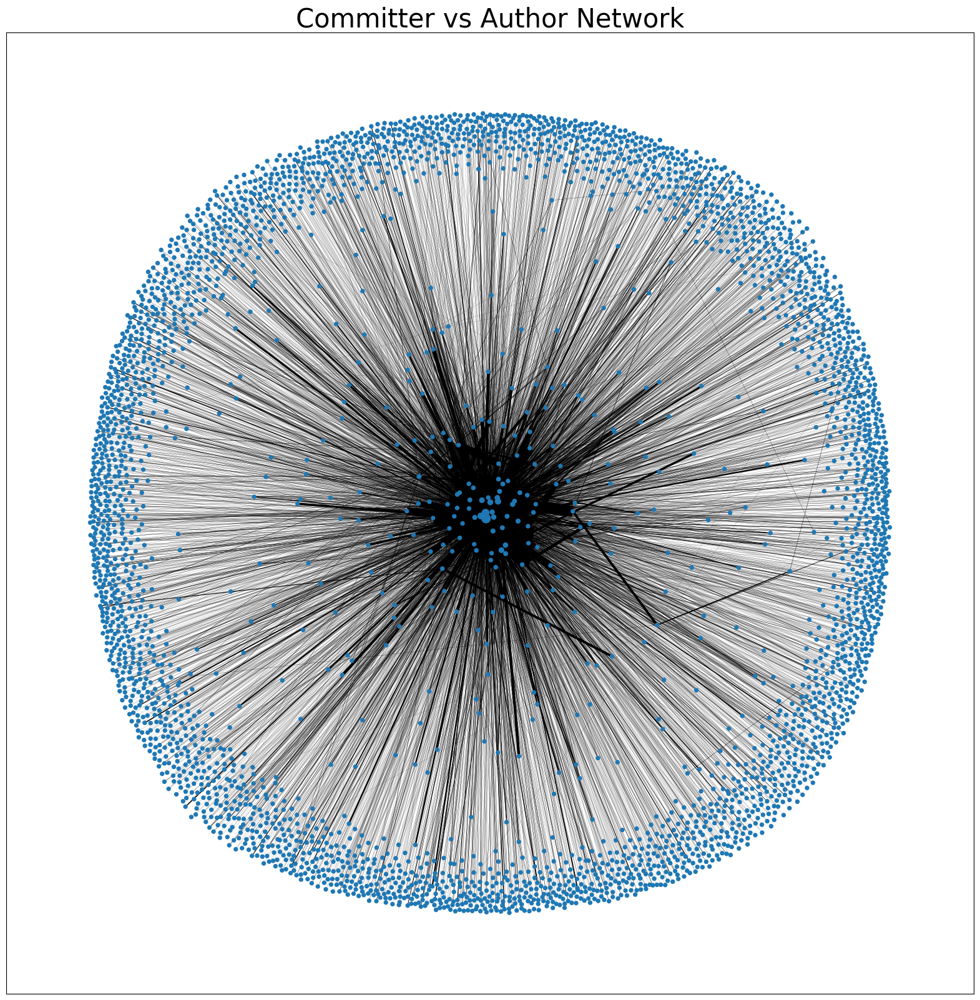

In [17]:
cmt_network = cmt_network.dropna()
G1 = nx.Graph()

edge_counts = cmt_network.groupby(['author_id', 'committer_id']).size()
for (author, committer), weight in edge_counts.iteritems():
    if author != committer:
        if not G1.has_node(author):
            G1.add_node(author)
        if not G1.has_node(committer):
            G1.add_node(committer)
        if G1.has_edge(author, committer):
            G1[author][committer]['weight'] += weight # increase weight
        else:
            G1.add_edge(author, committer, weight=weight)

# get centrality values for node sizes
centrality = nx.betweenness_centrality(G1)
min_centrality = min(centrality.values())
max_centrality = max(centrality.values())

# rescale 
norm_centrality = {node: (centrality[node] - min_centrality + 0.1) / (max_centrality - min_centrality + 0.1)
                         for node in G1.nodes()} # +0.1 to eliminate zero values
node_sizes = [v * 100 for v in norm_centrality.values()] # adjust node size based on centrality 

fig = plt.figure(figsize=(20, 20)) 
pos = nx.spring_layout(G1, k=0.5, iterations=50)
edge_widths = [G1[u][v]['weight'] * 0.1 for u,v in G1.edges()]
nx.draw_networkx_nodes(G1, pos, node_size=node_sizes) 
nx.draw_networkx_edges(G1, pos, width=edge_widths)
plt.axis('equal') 
plt.title('Committer vs Author Network', fontsize=30)
plt.show() 
fig.savefig('G1.png', bbox_inches='tight')

Creating a dictionary of node degrees in the graph G, sorting the degrees in descending order, and calculating the index of the threshold degree that corresponds to the top 20/10/5% of nodes.

In [18]:
avg_degree = sum(dict(G1.degree()).values()) / len(G1)
print("The average number of edges for nodes in the graph is:", avg_degree)

degrees = dict(G1.degree())
num_nodes = len(degrees)
sorted_degrees = sorted(degrees.values(), reverse=True)
threshold_idx = int(num_nodes * 0.2)
threshold20 = sorted_degrees[threshold_idx]
print("Top 20% threshold:", threshold20)
threshold_idx = int(num_nodes * 0.1)
threshold10 = sorted_degrees[threshold_idx]
print("Top 10% threshold:", threshold10)
threshold_idx = int(num_nodes * 0.05)
threshold5 = sorted_degrees[threshold_idx]
print("Top 5% threshold:", threshold5)

The average number of edges for nodes in the graph is: 3.2766990291262137
Top 20% threshold: 2
Top 10% threshold: 3
Top 5% threshold: 5


Color the nodes with high degree (greater than or equal to the threshold) in red and the nodes with low degree in blue.

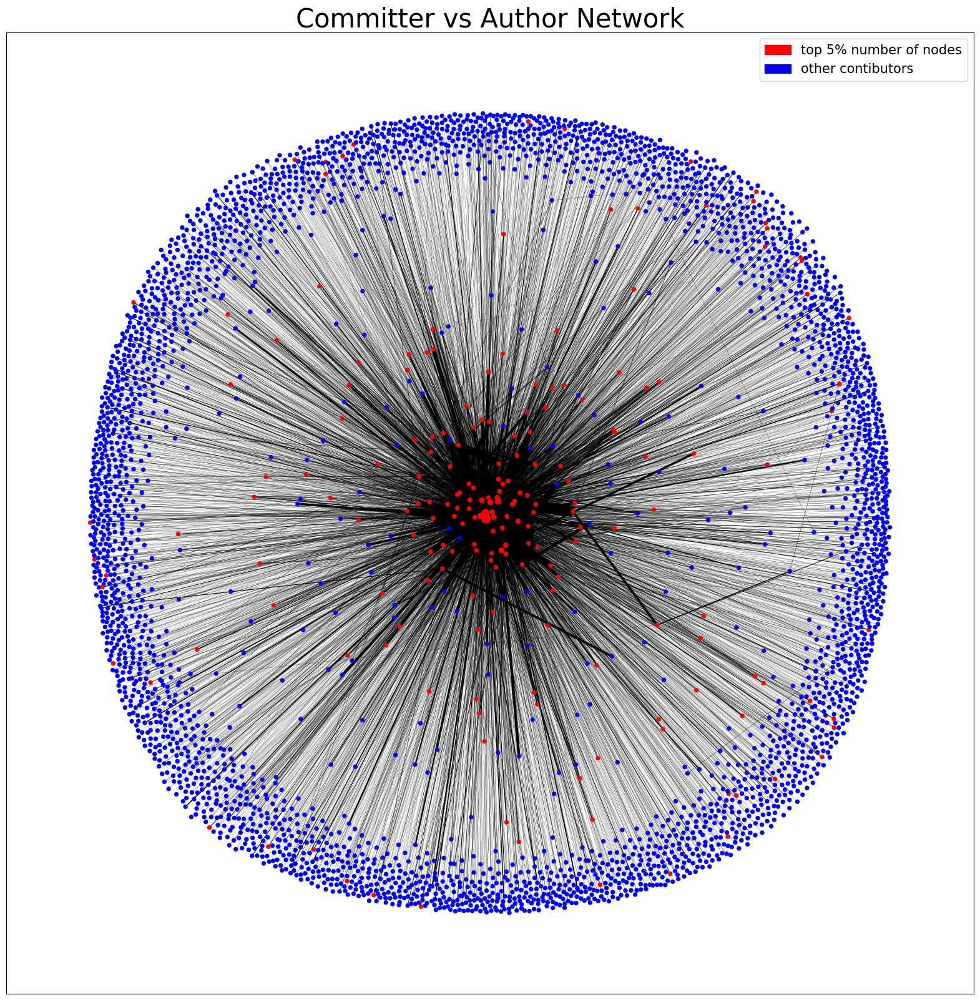

In [19]:
node_ids = list(G1.nodes())
node_colors = ['r' if degrees[n] >= threshold5 else 'b' for n in node_ids]

import matplotlib.patches as mpatches
fig, ax = plt.subplots(figsize=(20,20))
red_patch = mpatches.Patch(color='red', label='top 5% number of nodes')
blue_patch = mpatches.Patch(color='blue', label='other contibutors')
ax.legend(handles=[red_patch, blue_patch], fontsize = 15)
nx.draw_networkx_nodes(G1, pos, node_size=node_sizes, node_color=node_colors, ax=ax) 
nx.draw_networkx_edges(G1, pos, width=edge_widths, ax=ax)
plt.axis('equal') 
plt.title('Committer vs Author Network', fontsize = 30)
plt.show()
fig.savefig('G1_5%.png', bbox_inches='tight')

## Issue Message Network

Connect contributors if they've participated in an issue thread together. 

In [23]:
repo_org = 'ansible'
repo_name = 'ansible-2'
ism_query = salc.sql.text(f"""
                 SET SCHEMA 'augur_data';
                 SELECT 
                    i.issue_id, 
                    m.cntrb_id 
                FROM
                    repo_groups rg,
                    repo r,
                    issues i, 
                    issue_message_ref imr, 
                    message m
                WHERE
                    rg.repo_group_id = r.repo_group_id AND
                    i.repo_id = r.repo_id AND
                    i.issue_id = imr.issue_id AND
                    m.msg_id = imr.msg_id AND
                    rg.rg_name = \'{repo_org}\' AND
                    r.repo_name = \'{repo_name}\'
                GROUP BY
                    i.issue_id, 
                    m.cntrb_id
        """)
    
ism_data = pd.read_sql(ism_query, con=engine)
display(ism_data)

,issue_id,cntrb_id
0,1286643,01000045-2400-0000-0000-000000000000
1,1286643,01000b5b-1400-0000-0000-000000000000
2,1286643,01001c87-8900-0000-0000-000000000000
3,1286659,01000045-2400-0000-0000-000000000000
4,1286659,01000c17-fc00-0000-0000-000000000000
...,...,...
9052,1317424,01000045-2400-0000-0000-000000000000
9053,1317427,01000077-9000-0000-0000-000000000000
9054,1317427,01000bb1-ec00-0000-0000-000000000000
9055,1317427,01003d33-1a00-0000-0000-000000000000


Group contributor IDs on issue ID and remove rows with only one contributor (no edges)

In [24]:
ism_network = ism_data.groupby('issue_id')['cntrb_id'].apply(list).reset_index()
ism_network = ism_network[ism_network['cntrb_id'].apply(lambda x: len(x) > 1)]

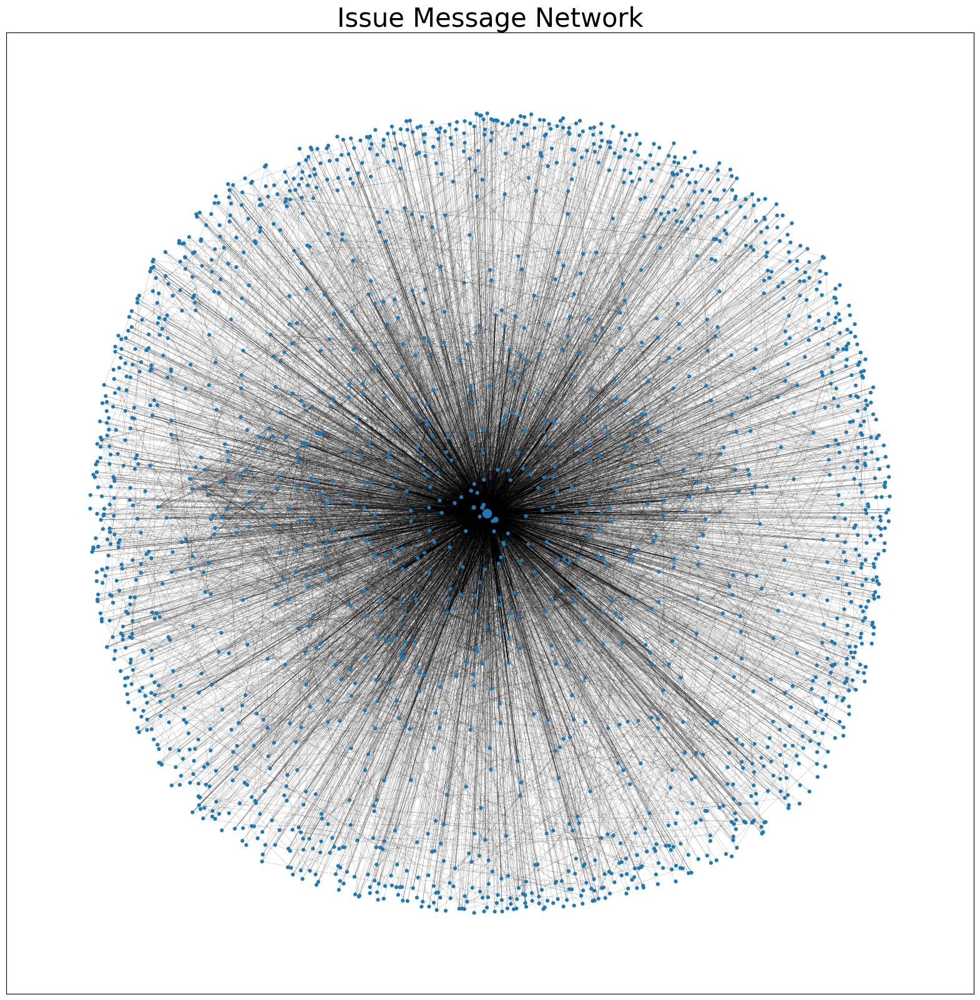

In [28]:
G2 = nx.Graph()

for row in ism_network.itertuples():
    issue_id = row.issue_id
    contributors = row.cntrb_id
    for cntrb in contributors:
        if not G2.has_node(cntrb):
          G2.add_node(cntrb)
    for i in range(len(contributors)):
        for j in range(i+1, len(contributors)):
            if contributors[i] != contributors[j]:
               if G2.has_edge(contributors[i], contributors[j]):
                  G2[contributors[i]][contributors[j]]['weight'] += weight # increase weight
               else:
                  G2.add_edge(contributors[i], contributors[j], issue=issue_id, weight=weight)

# get centrality values for node sizes
centrality = nx.betweenness_centrality(G2)
min_centrality = min(centrality.values())
max_centrality = max(centrality.values())

# rescale 
norm_centrality = {node: (centrality[node] - min_centrality + 0.1) / (max_centrality - min_centrality + 0.1)
                         for node in G2.nodes()} # +0.1 to eliminate zero values
node_sizes = [v * 100 for v in norm_centrality.values()] # adjust node size based on centrality 

fig = plt.figure(figsize=(20, 20)) 
pos = nx.spring_layout(G2, k=0.5, iterations=50)
edge_widths = [G2[u][v]['weight'] * 0.1 for u,v in G2.edges()]
nx.draw_networkx_nodes(G2, pos, node_size=node_sizes) 
nx.draw_networkx_edges(G2, pos, width=edge_widths)
plt.axis('equal') 
plt.title('Issue Message Network', fontsize = 30)
plt.show() 
fig.savefig('G2.png', bbox_inches='tight')

In [29]:
avg_degree = sum(dict(G2.degree()).values()) / len(G2)
print("The average number of edges for nodes in the graph is:", avg_degree)

degrees = dict(G2.degree())
num_nodes = len(degrees)
sorted_degrees = sorted(degrees.values(), reverse=True)
threshold_idx = int(num_nodes * 0.2)
threshold20 = sorted_degrees[threshold_idx]
print("Top 20% threshold:", threshold20)
threshold_idx = int(num_nodes * 0.1)
threshold10 = sorted_degrees[threshold_idx]
print("Top 10% threshold:", threshold10)
threshold_idx = int(num_nodes * 0.05)
threshold5 = sorted_degrees[threshold_idx]
print("Top 5% threshold:", threshold5)

The average number of edges for nodes in the graph is: 7.811240721102863
Top 20% threshold: 8
Top 10% threshold: 14
Top 5% threshold: 21


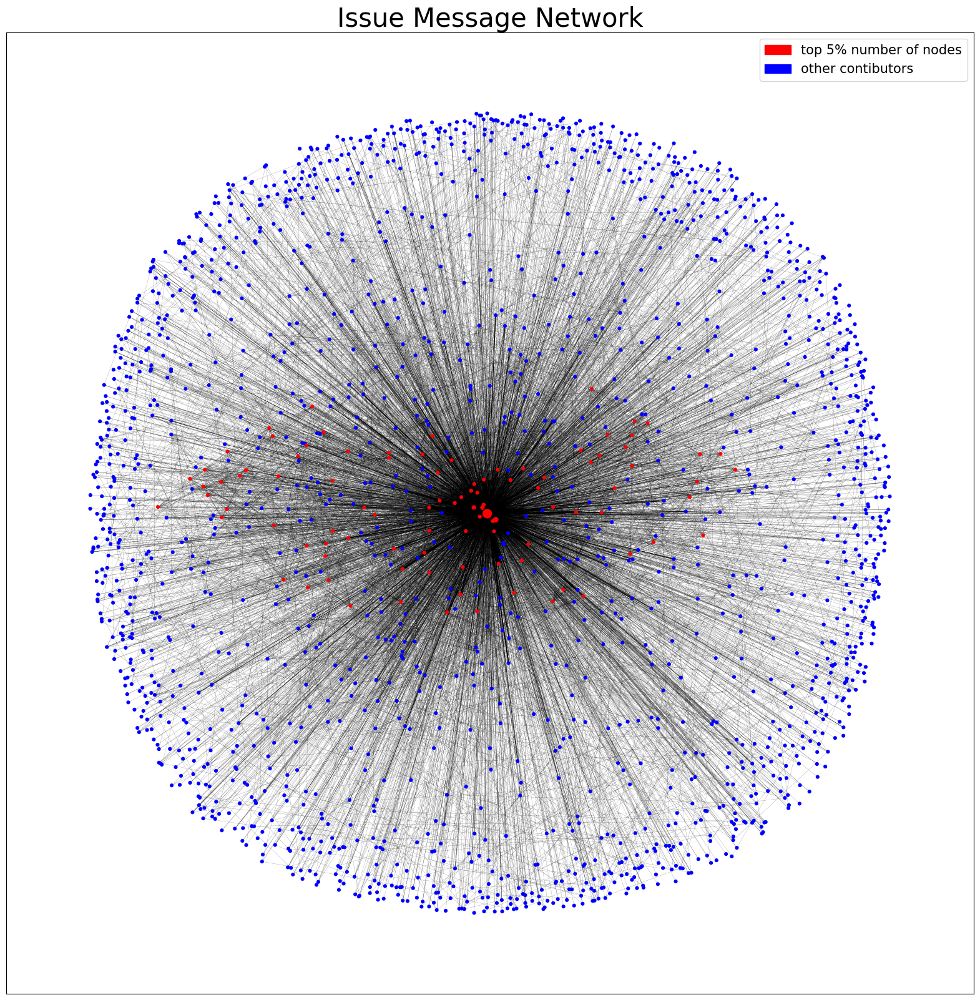

In [31]:
node_ids = list(G2.nodes())
node_colors = ['r' if degrees[n] >= threshold5 else 'b' for n in node_ids]

import matplotlib.patches as mpatches
fig, ax = plt.subplots(figsize=(20,20))
red_patch = mpatches.Patch(color='red', label='top 5% number of nodes')
blue_patch = mpatches.Patch(color='blue', label='other contibutors')
ax.legend(handles=[red_patch, blue_patch], fontsize = 15)
nx.draw_networkx_nodes(G2, pos, node_size=node_sizes, node_color=node_colors, ax=ax) 
nx.draw_networkx_edges(G2, pos, width=edge_widths, ax=ax)
plt.axis('equal') 
plt.title('Issue Message Network', fontsize = 30)
plt.show()

fig.savefig('G2_5%.png', bbox_inches='tight')

## PR review network 

Connect contributors if one has reviewed the other's PR.

In [32]:
repo_org = 'ansible'
repo_name = 'ansible-2'
pr_query = salc.sql.text(f"""
                 SET SCHEMA 'augur_data';
                 SELECT 
                    pr.pull_request_id, 
                    pre.cntrb_id, 
                    prr.cntrb_id as reviewer
                FROM
                    repo_groups rg,
                    repo r,
                    pull_requests pr, 
                    pull_request_events pre, 
                    pull_request_reviewers prr
                WHERE
                    rg.repo_group_id = r.repo_group_id AND
                    pr.repo_id = r.repo_id AND
                    pr.pull_request_id = pre.pull_request_id AND
                    pr.pull_request_id = prr.pull_request_id AND 
                    pre.cntrb_id != prr.cntrb_id AND 
                    rg.rg_name = \'{repo_org}\' AND
                    r.repo_name = \'{repo_name}\'
                GROUP BY
                    pr.pull_request_id, 
                    pre.cntrb_id, 
                    prr.cntrb_id
        """)
    
pr_network = pd.read_sql(pr_query, con=engine)
display(pr_network)

,pull_request_id,cntrb_id,reviewer
0,1547317,01000099-ac00-0000-0000-000000000000,010009ab-a500-0000-0000-000000000000
1,1547317,01000099-ac00-0000-0000-000000000000,01000cc2-4b00-0000-0000-000000000000
2,1547317,01001700-7c00-0000-0000-000000000000,010009ab-a500-0000-0000-000000000000
3,1547317,01001700-7c00-0000-0000-000000000000,01000cc2-4b00-0000-0000-000000000000
4,1547335,010008d3-ef00-0000-0000-000000000000,01012aa8-bd00-0000-0000-000000000000
...,...,...,...
1329,68493813,01000c4d-d800-0000-0000-000000000000,01000cc2-4b00-0000-0000-000000000000
1330,68493813,01001700-7c00-0000-0000-000000000000,01000cc2-4b00-0000-0000-000000000000
1331,68493813,01005837-6c00-0000-0000-000000000000,01000cc2-4b00-0000-0000-000000000000
1332,68493813,0100647b-c300-0000-0000-000000000000,01000cc2-4b00-0000-0000-000000000000


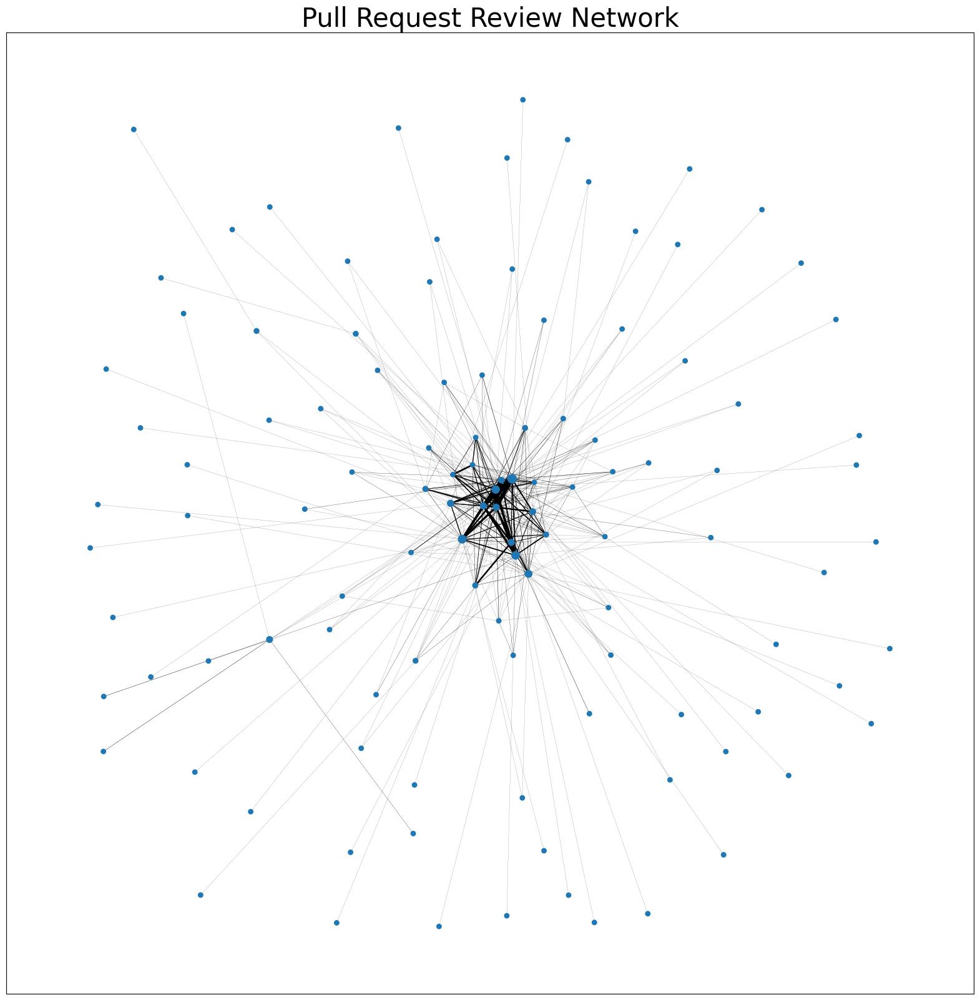

In [37]:
pr_network = pr_network.dropna()

G3 = nx.Graph()
for _, row in pr_network.iterrows():
    if row['cntrb_id'] != row['reviewer']:
      if not G3.has_node(row['cntrb_id']):
          G3.add_node(row['cntrb_id'])
      if not G3.has_node(row['reviewer']):
          G3.add_node(row['reviewer'])
      if G3.has_edge(row['cntrb_id'], row['reviewer']):
          G3[row['cntrb_id']][row['reviewer']]['weight'] += weight 
      else:
          G3.add_edge(row['cntrb_id'], row['reviewer'], weight=weight)

centrality = nx.betweenness_centrality(G3)
min_centrality = min(centrality.values())
max_centrality = max(centrality.values())

norm_centrality = {node: (centrality[node] - min_centrality + 0.1) / (max_centrality - min_centrality + 0.1)
                         for node in G3.nodes()} 
node_sizes = [v * 100 for v in norm_centrality.values()] 

fig = plt.figure(figsize=(20, 20)) 
pos = nx.spring_layout(G3, k=0.5, iterations=50)
edge_widths = [G3[u][v]['weight'] * 0.1 for u,v in G3.edges()]
nx.draw_networkx_nodes(G3, pos, node_size=node_sizes) 
nx.draw_networkx_edges(G3, pos, width=edge_widths)
plt.axis('equal') 
plt.title('Pull Request Review Network', fontsize = 30)
plt.show() 
fig.savefig('G3.png', bbox_inches='tight')

In [38]:
avg_degree = sum(dict(G3.degree()).values()) / len(G3)
print("The average number of edges for nodes in the graph is:", avg_degree)

degrees = dict(G3.degree())
num_nodes = len(degrees)
sorted_degrees = sorted(degrees.values(), reverse=True)
threshold_idx = int(num_nodes * 0.2)
threshold20 = sorted_degrees[threshold_idx]
print("Top 20% threshold:", threshold20)
threshold_idx = int(num_nodes * 0.1)
threshold10 = sorted_degrees[threshold_idx]
print("Top 10% threshold:", threshold10)
threshold_idx = int(num_nodes * 0.05)
threshold5 = sorted_degrees[threshold_idx]
print("Top 5% threshold:", threshold5)

The average number of edges for nodes in the graph is: 5.75
Top 20% threshold: 7
Top 10% threshold: 19
Top 5% threshold: 31


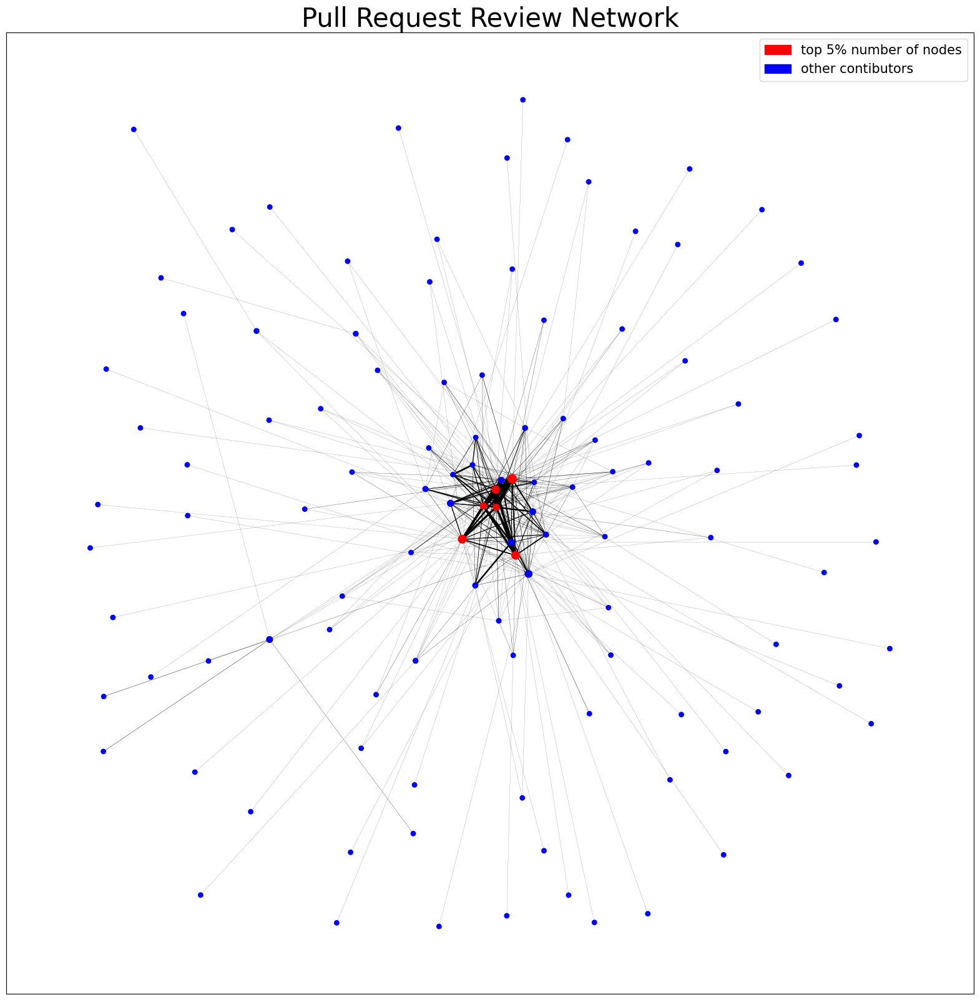

In [40]:
node_ids = list(G3.nodes())
node_colors = ['r' if degrees[n] >= threshold5 else 'b' for n in node_ids]

import matplotlib.patches as mpatches
fig, ax = plt.subplots(figsize=(20,20))
red_patch = mpatches.Patch(color='red', label='top 5% number of nodes')
blue_patch = mpatches.Patch(color='blue', label='other contibutors')
ax.legend(handles=[red_patch, blue_patch], fontsize = 15)
nx.draw_networkx_nodes(G3, pos, node_size=node_sizes, node_color=node_colors, ax=ax) 
nx.draw_networkx_edges(G3, pos, width=edge_widths, ax=ax)
plt.axis('equal') 
plt.title('Pull Request Review Network', fontsize = 30)
plt.show()

fig.savefig('G3_5%.png', bbox_inches='tight')

## PR message network

Connect contributors if they've participated in the same PR message series together.


In [41]:
repo_org = 'ansible'
repo_name = 'ansible-2'
prm_query = salc.sql.text(f"""
                 SET SCHEMA 'augur_data';
                 SELECT 
                    pr.pull_request_id, 
                    m.cntrb_id 
                FROM
                    repo_groups rg,
                    repo r,
                    pull_requests pr, 
                    pull_request_message_ref prm, 
                    message m
                WHERE
                    rg.repo_group_id = r.repo_group_id AND
                    pr.repo_id = r.repo_id AND
                    pr.pull_request_id = prm.pull_request_id AND
                    m.msg_id = prm.msg_id AND
                    rg.rg_name = \'{repo_org}\' AND
                    r.repo_name = \'{repo_name}\'
                GROUP BY
                    pr.pull_request_id, 
                    m.cntrb_id
        """)
    
prm_data = pd.read_sql(prm_query, con=engine)
display(prm_data)

,pull_request_id,cntrb_id
0,3620983,01000045-2400-0000-0000-000000000000
1,3620983,010002fa-0100-0000-0000-000000000000
2,3620983,01000cc2-4b00-0000-0000-000000000000
3,3620986,01000045-2400-0000-0000-000000000000
4,3620989,01000045-2400-0000-0000-000000000000
...,...,...
9060,3670046,01001c87-8900-0000-0000-000000000000
9061,3670072,01000045-2400-0000-0000-000000000000
9062,3670073,01000045-2400-0000-0000-000000000000
9063,3670082,01000045-2400-0000-0000-000000000000


In [42]:
prm_network = prm_data.groupby('pull_request_id')['cntrb_id'].apply(list).reset_index()
prm_network = prm_network[prm_network['cntrb_id'].apply(lambda x: len(x) > 1)]

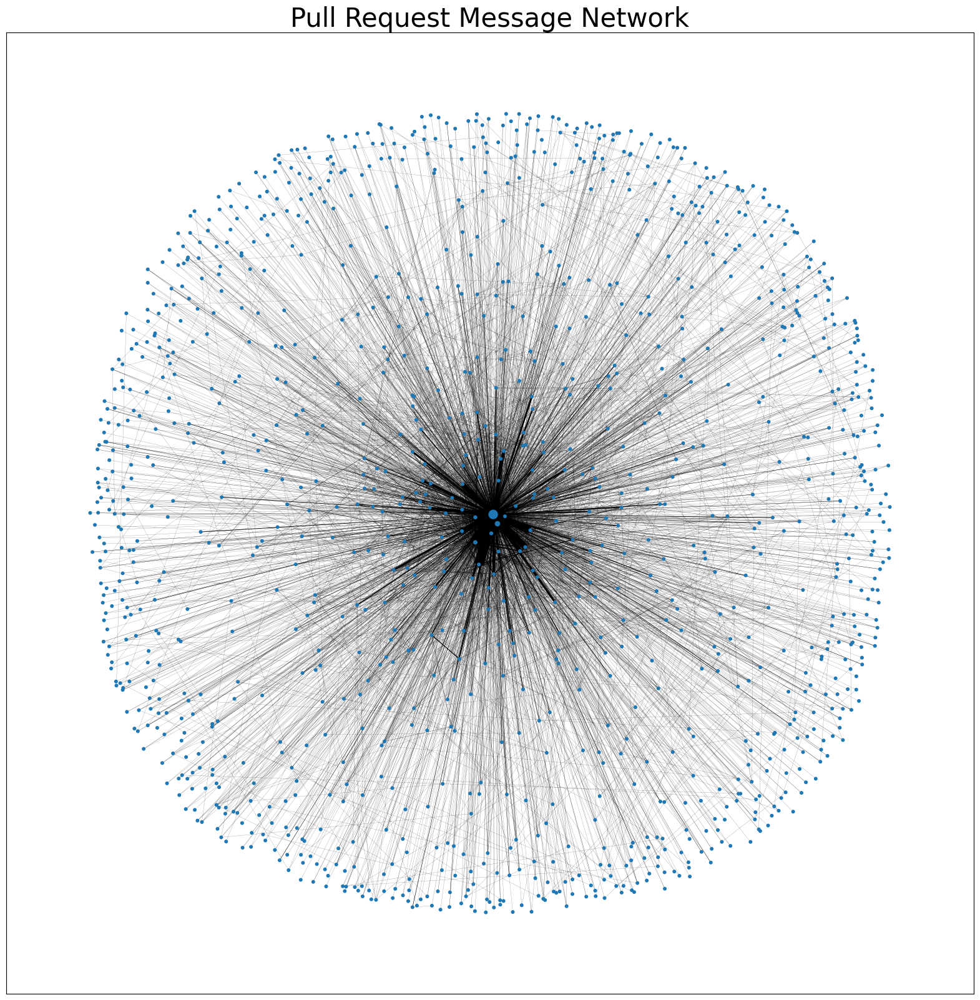

In [43]:
G4 = nx.Graph()

for row in prm_network.itertuples():
    pr_id = row.pull_request_id	
    contributors = row.cntrb_id
    
    for cntrb in contributors:
        if not G1.has_node(cntrb):
            G4.add_node(cntrb)

    for i in range(len(contributors)):
        for j in range(i+1, len(contributors)):
            if contributors[i] != contributors[j]:
               if G4.has_edge(contributors[i], contributors[j]):
                  G4[contributors[i]][contributors[j]]['weight'] += weight
               else:
                  G4.add_edge(contributors[i], contributors[j], pr=pr_id, weight=weight)

centrality = nx.betweenness_centrality(G4)
min_centrality = min(centrality.values())
max_centrality = max(centrality.values())

norm_centrality = {node: (centrality[node] - min_centrality + 0.1) / (max_centrality - min_centrality + 0.1)
                         for node in G4.nodes()} 
node_sizes = [v * 100 for v in norm_centrality.values()]

fig = plt.figure(figsize=(20, 20)) 
pos = nx.spring_layout(G4, k=0.5, iterations=50)
edge_widths = [G4[u][v]['weight'] * 0.1 for u,v in G4.edges()]
nx.draw_networkx_nodes(G4, pos, node_size=node_sizes) 
nx.draw_networkx_edges(G4, pos, width=edge_widths)
plt.axis('equal') 
plt.title('Pull Request Message Network', fontsize = 30)
plt.show() 
fig.savefig('G4.png', bbox_inches='tight')

In [44]:
avg_degree = sum(dict(G4.degree()).values()) / len(G4)
print("The average number of edges for nodes in the graph is:", avg_degree)

degrees = dict(G4.degree())
num_nodes = len(degrees)
sorted_degrees = sorted(degrees.values(), reverse=True)
threshold_idx = int(num_nodes * 0.2)
threshold20 = sorted_degrees[threshold_idx]
print("Top 20% threshold:", threshold20)
threshold_idx = int(num_nodes * 0.1)
threshold10 = sorted_degrees[threshold_idx]
print("Top 10% threshold:", threshold10)
threshold_idx = int(num_nodes * 0.05)
threshold5 = sorted_degrees[threshold_idx]
print("Top 5% threshold:", threshold5)

The average number of edges for nodes in the graph is: 5.854812398042414
Top 20% threshold: 6
Top 10% threshold: 9
Top 5% threshold: 13


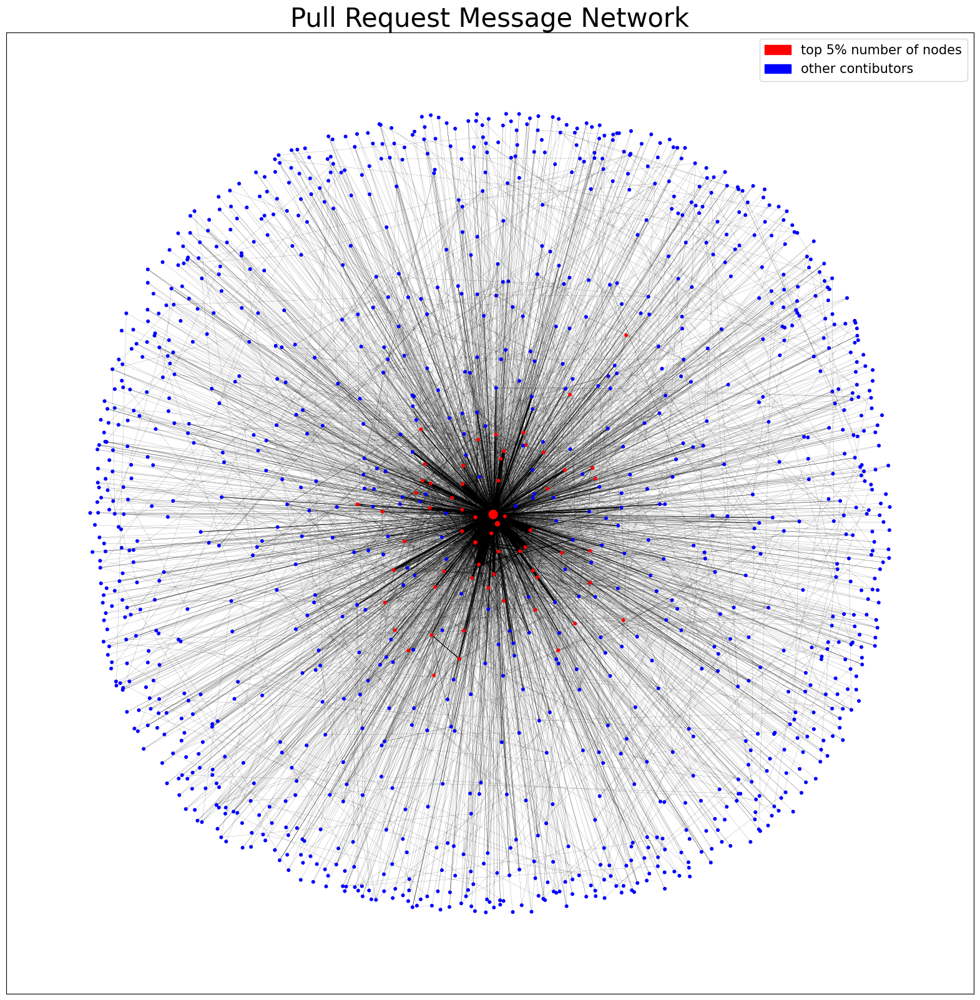

In [45]:
node_ids = list(G4.nodes())
node_colors = ['r' if degrees[n] >= threshold5 else 'b' for n in node_ids]

import matplotlib.patches as mpatches
fig, ax = plt.subplots(figsize=(20,20))
red_patch = mpatches.Patch(color='red', label='top 5% number of nodes')
blue_patch = mpatches.Patch(color='blue', label='other contibutors')
ax.legend(handles=[red_patch, blue_patch], fontsize = 15)
nx.draw_networkx_nodes(G4, pos, node_size=node_sizes, node_color=node_colors, ax=ax) 
nx.draw_networkx_edges(G4, pos, width=edge_widths, ax=ax)
plt.axis('equal') 
plt.title('Pull Request Message Network', fontsize = 30)
plt.show()

fig.savefig('G4_5%.png', bbox_inches='tight')

## Combine networks

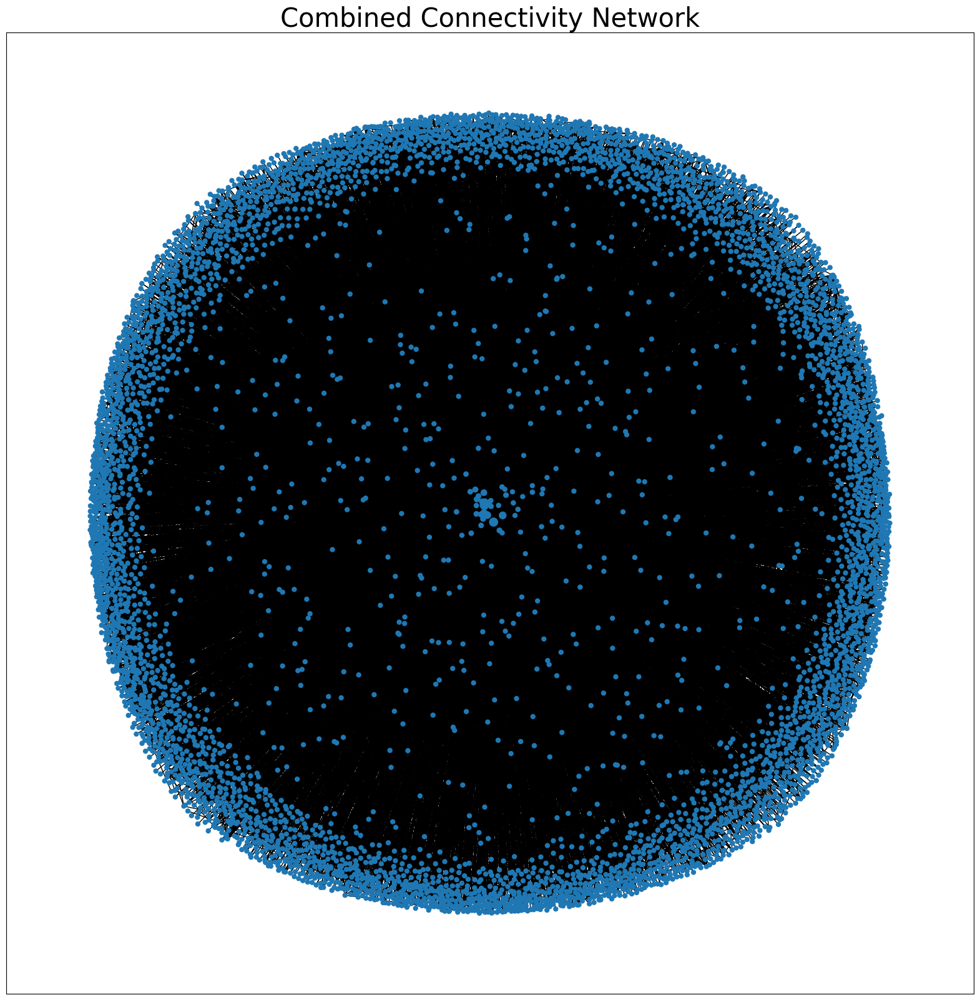

In [48]:
# combine the networks into one graph
Gall = nx.Graph()
for graph in [G1, G2, G3, G4]:
    Gall.add_nodes_from(graph.nodes())
    Gall.add_edges_from(graph.edges())

centrality = nx.betweenness_centrality(Gall)
min_centrality = min(centrality.values())
max_centrality = max(centrality.values())

norm_centrality = {node: (centrality[node] - min_centrality + 0.1) / (max_centrality - min_centrality + 0.1)
                         for node in Gall.nodes()} 
node_sizes = [v * 100 for v in norm_centrality.values()]

fig = plt.figure(figsize=(20, 20)) 
pos = nx.spring_layout(Gall, k=0.5, iterations=50)
#edge_widths = [Gall[u][v]['weight'] * 0.1 for u,v in Gall.edges()]
nx.draw_networkx_nodes(Gall, pos, node_size=node_sizes) 
#nx.draw_networkx_edges(Gall, pos, width=edge_widths) 
nx.draw_networkx_edges(Gall, pos) 
plt.axis('equal') 
plt.title('Combined Connectivity Network', fontsize = 30)
plt.show() 
fig.savefig('allG.png', bbox_inches='tight')

Identify contributors with the highest degree (number of connections)

In [49]:
degrees = dict(Gall.degree())

sorted_nodes = sorted(degrees, key=lambda x: degrees[x], reverse=True)

print('Contributors with the highest degrees:')
print('cntrb_id : degree' )
for node in sorted_nodes[:10]:
    print(f"{node} : {degrees[node]}")

Contributors with the highest degrees:
cntrb_id : degree
01000045-2400-0000-0000-000000000000 : 2171
01000c4d-d800-0000-0000-000000000000 : 1186
01000067-2300-0000-0000-000000000000 : 973
01000cc2-4b00-0000-0000-000000000000 : 957
01012f1b-7f00-0000-0000-000000000000 : 651
01001c87-8900-0000-0000-000000000000 : 601
01000e5a-0d00-0000-0000-000000000000 : 439
01000099-ac00-0000-0000-000000000000 : 325
01000331-5a00-0000-0000-000000000000 : 319
0100005d-0100-0000-0000-000000000000 : 305
